In [2]:
import os
import random
import torch
import torch.nn as nn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as datasets
import torchvision.transforms as T
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import pickle

random.seed(333)
torch.manual_seed(333)

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
data_path = '/content/drive/My Drive/Colab Notebooks/data'
print(device)

cuda


In [4]:
torch.cuda.get_device_name(0)

'Tesla V100-SXM2-16GB'

### Code for calculating FID
This whole code is taken from https://github.com/mseitzer/pytorch-fid <br>
I have made few changes as per my requirements.

In [4]:
from scipy import linalg

from inception import InceptionV3


class ImagesPathDataset(torch.utils.data.Dataset):
    def __init__(self, files, transforms=None):
        self.files = files
        self.transforms = transforms

    def __len__(self):
        return len(self.files)

    def __getitem__(self, i):
        img = self.files[i]
        # img = Image.open(path).convert('RGB')
        if self.transforms is not None:
            img = self.transforms(img)
        return img

def get_activations(files, model, batch_size=50, dims=2048, device='cpu'):
    """Calculates the activations of the pool_3 layer for all images.
    Params:
    -- files       : List of image files paths
    -- model       : Instance of inception model
    -- batch_size  : Batch size of images for the model to process at once.
                     Make sure that the number of samples is a multiple of
                     the batch size, otherwise some samples are ignored. This
                     behavior is retained to match the original FID score
                     implementation.
    -- dims        : Dimensionality of features returned by Inception
    -- device      : Device to run calculations
    Returns:
    -- A numpy array of dimension (num images, dims) that contains the
       activations of the given tensor when feeding inception with the
       query tensor.
    """
    model.eval()

    if batch_size > len(files):
        print(('Warning: batch size is bigger than the data size. '
               'Setting batch size to data size'))
        batch_size = len(files)

    ds = ImagesPathDataset(files)
    dl = torch.utils.data.DataLoader(ds, batch_size=batch_size,
                                     drop_last=False, num_workers=32)

    pred_arr = np.empty((len(files), dims))

    start_idx = 0

    for batch in dl:
        batch = batch.to(device)

        with torch.no_grad():
            pred = model(batch)[0]

        # If model output is not scalar, apply global spatial average pooling.
        # This happens if you choose a dimensionality not equal 2048.
        if pred.size(2) != 1 or pred.size(3) != 1:
            pred = adaptive_avg_pool2d(pred, output_size=(1, 1))

        pred = pred.squeeze(3).squeeze(2).cpu().numpy()

        pred_arr[start_idx:start_idx + pred.shape[0]] = pred

        start_idx = start_idx + pred.shape[0]

    return pred_arr


def calculate_frechet_distance(mu1, sigma1, mu2, sigma2, eps=1e-6):
    """Numpy implementation of the Frechet Distance.
    The Frechet distance between two multivariate Gaussians X_1 ~ N(mu_1, C_1)
    and X_2 ~ N(mu_2, C_2) is
            d^2 = ||mu_1 - mu_2||^2 + Tr(C_1 + C_2 - 2*sqrt(C_1*C_2)).
    Stable version by Dougal J. Sutherland.
    Params:
    -- mu1   : Numpy array containing the activations of a layer of the
               inception net (like returned by the function 'get_predictions')
               for generated samples.
    -- mu2   : The sample mean over activations, precalculated on an
               representative data set.
    -- sigma1: The covariance matrix over activations for generated samples.
    -- sigma2: The covariance matrix over activations, precalculated on an
               representative data set.
    Returns:
    --   : The Frechet Distance.
    """

    mu1 = np.atleast_1d(mu1)
    mu2 = np.atleast_1d(mu2)

    sigma1 = np.atleast_2d(sigma1)
    sigma2 = np.atleast_2d(sigma2)

    assert mu1.shape == mu2.shape, \
        'Training and test mean vectors have different lengths'
    assert sigma1.shape == sigma2.shape, \
        'Training and test covariances have different dimensions'

    diff = mu1 - mu2

    # Product might be almost singular
    covmean, _ = linalg.sqrtm(sigma1.dot(sigma2), disp=False)
    if not np.isfinite(covmean).all():
        msg = ('fid calculation produces singular product; '
               'adding %s to diagonal of cov estimates') % eps
        print(msg)
        offset = np.eye(sigma1.shape[0]) * eps
        covmean = linalg.sqrtm((sigma1 + offset).dot(sigma2 + offset))

    # Numerical error might give slight imaginary component
    if np.iscomplexobj(covmean):
        if not np.allclose(np.diagonal(covmean).imag, 0, atol=1e-3):
            m = np.max(np.abs(covmean.imag))
            raise ValueError('Imaginary component {}'.format(m))
        covmean = covmean.real

    tr_covmean = np.trace(covmean)

    return (diff.dot(diff) + np.trace(sigma1) +
            np.trace(sigma2) - 2 * tr_covmean)


def calculate_activation_statistics(files, model, batch_size=50, dims=2048, device='cpu'):
    """Calculation of the statistics used by the FID.
    Params:
    -- files       : List of image files paths
    -- model       : Instance of inception model
    -- batch_size  : The images numpy array is split into batches with
                     batch size batch_size. A reasonable batch size
                     depends on the hardware.
    -- dims        : Dimensionality of features returned by Inception
    -- device      : Device to run calculations
    Returns:
    -- mu    : The mean over samples of the activations of the pool_3 layer of
               the inception model.
    -- sigma : The covariance matrix of the activations of the pool_3 layer of
               the inception model.
    """
    act = get_activations(files, model, batch_size, dims, device)
    mu = np.mean(act, axis=0)
    sigma = np.cov(act, rowvar=False)
    return mu, sigma


def _compute_statistics_of_path(path, model, batch_size, dims, device):
    # if path.endswith('.npz'):
    #     f = np.load(path)
    #     m, s = f['mu'][:], f['sigma'][:]
    #     f.close()
    # else:
    #     path = pathlib.Path(path)
    #     files = list(path.glob('*.jpg')) + list(path.glob('*.png'))
    m, s = calculate_activation_statistics(path, model, batch_size,
                                               dims, device)

    return m, s


def calculate_fid(m1, s1, path, batch_size, device, dims):
    """Calculates the FID of two paths"""
    # for p in paths:
    #     if not os.path.exists(p):
    #         raise RuntimeError('Invalid path: %s' % p)

    model = getModel(dims)

    # m1, s1 = _compute_statistics_of_path(paths[0], model, batch_size,
    #                                      dims, device)
    m2, s2 = _compute_statistics_of_path(path, model, batch_size,
                                         dims, device)
    fid_value = calculate_frechet_distance(m1, s1, m2, s2)

    return fid_value

def getModel(dims):
    block_idx = InceptionV3.BLOCK_INDEX_BY_DIM[dims]
    model = InceptionV3([block_idx]).to(device)
    return model

### Data Loader

here


Traceback (most recent call last):
  File "/usr/lib/python3.6/multiprocessing/util.py", line 262, in _run_finalizers
    finalizer()
  File "/usr/lib/python3.6/multiprocessing/util.py", line 186, in __call__
    res = self._callback(*self._args, **self._kwargs)
  File "/usr/lib/python3.6/shutil.py", line 490, in rmtree
    onerror(os.rmdir, path, sys.exc_info())
  File "/usr/lib/python3.6/shutil.py", line 488, in rmtree
    os.rmdir(path)
OSError: [Errno 39] Directory not empty: '/tmp/pymp-1et5tyqs'


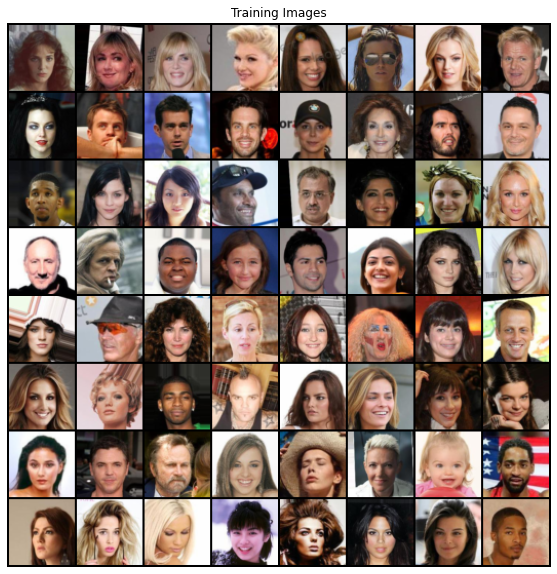

In [18]:
batch_size = 128
img_transform  = T.Compose([T.Resize(64), T.CenterCrop(64), T.ToTensor(), T.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])
dataset = datasets.ImageFolder(root = data_path, transform = img_transform)

dataloader = torch.utils.data.DataLoader(dataset, batch_size = batch_size, shuffle = True, num_workers = 128, drop_last = True)

print('here')
real_batch = next(iter(dataloader))
plt.figure(figsize = (10,10))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding = 2, normalize = True).cpu(), (1,2,0)))

In [5]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.xavier_uniform_(m.weight)
        m.bias.data.fill_(0.)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [6]:
class selfAttention(nn.Module):
    def __init__(self, input_size):
        super(selfAttention, self).__init__()

        self.query = nn.Conv2d(input_size , input_size // 8 , kernel_size = 1)
        self.key = nn.Conv2d(input_size , input_size // 8 , kernel_size = 1)
        self.value = nn.Conv2d(input_size , input_size , kernel_size = 1)
        
        self.gamma = nn.Parameter(torch.zeros(1))

        self.softmax  = nn.Softmax(dim = -1)

    def forward(self, x):
        b, c, h, w = x.size()

        q = self.query(x).view(b, -1 , h * w)
        k = self.key(x).view(b, -1 , h * w)
        v = self.value(x).view(b, -1 , h * w)
        
        attention = self.softmax(torch.bmm(q.permute(0, 2, 1), k))

        out = torch.bmm(v, attention)
        out = out.view(b, c, h, w)
        
        out = self.gamma * out + x
        return out

In [7]:
class Generator(nn.Module):
    def __init__(self, input_size):
        super(Generator, self).__init__()
        
        self.conv1 = nn.utils.spectral_norm(nn.ConvTranspose2d(input_size, 512, kernel_size = 4, stride = 1, padding = 0))
        self.batch1 = nn.BatchNorm2d(512)
        self.relu1 = nn.ReLU(True)

        self.conv2 = nn.utils.spectral_norm(nn.ConvTranspose2d(512, 256, kernel_size = 4, stride = 2, padding = 1))
        self.batch2 = nn.BatchNorm2d(256)
        self.relu2 = nn.ReLU(True)

        self.conv3 = nn.utils.spectral_norm(nn.ConvTranspose2d(256, 128, kernel_size = 4, stride = 2, padding = 1))
        self.batch3 = nn.BatchNorm2d(128)
        self.relu3 = nn.ReLU(True)

        self.attn1 = selfAttention(128)

        self.conv4 = nn.utils.spectral_norm(nn.ConvTranspose2d(128, 64, kernel_size = 4, stride = 2, padding = 1))
        self.batch4 = nn.BatchNorm2d(64)
        self.relu4 = nn.ReLU(True)

        # self.attn2 = selfAttention(64)

        self.conv5 = nn.ConvTranspose2d(64, 3, kernel_size = 4, stride = 2, padding = 1)
        self.tanh = nn.Tanh()

    def forward(self, input):
        x = self.relu1(self.batch1(self.conv1(input)))
        x = self.relu2(self.batch2(self.conv2(x)))
        x = self.relu3(self.batch3(self.conv3(x)))
        x = self.attn1(x)
        x = self.relu4(self.batch4(self.conv4(x)))
        # x = self.attn2(x)
        x = self.tanh(self.conv5(x))
        return x


In [8]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        
        self.conv1 = nn.utils.spectral_norm(nn.Conv2d(3, 64, kernel_size = 4, stride = 2, padding = 1))
        # self.batch1 = nn.BatchNorm2d(64)
        self.leaky_relu1 = nn.LeakyReLU(0.2, True)

        self.conv2 = nn.utils.spectral_norm(nn.Conv2d(64, 128, kernel_size = 4, stride = 2, padding = 1))
        self.batch2 = nn.BatchNorm2d(128)
        self.leaky_relu2 = nn.LeakyReLU(0.2, True)

        self.conv3 = nn.utils.spectral_norm(nn.Conv2d(128, 256, kernel_size = 4, stride = 2, padding = 1))
        self.batch3 = nn.BatchNorm2d(256)
        self.leaky_relu3 = nn.LeakyReLU(0.2, True)

        self.attn1 = selfAttention(256)

        self.conv4 = nn.utils.spectral_norm(nn.Conv2d(256, 512, kernel_size = 4, stride = 2, padding = 1))
        self.batch4 = nn.BatchNorm2d(512)
        self.leaky_relu4 = nn.LeakyReLU(0.2, True)

        # self.attn2 = selfAttention(512)

        self.conv5 = nn.Conv2d(512, 1, kernel_size = 4, stride = 1, padding = 0)
        self.sigmoid = nn.Sigmoid()

    def forward(self, input):
        x = self.leaky_relu1(self.conv1(input))
        x = self.leaky_relu2(self.batch2(self.conv2(x)))
        x = self.leaky_relu3(self.batch3(self.conv3(x)))
        x = self.attn1(x)
        x = self.leaky_relu4(self.batch4(self.conv4(x)))
        # x = self.attn2(x)
        x = self.sigmoid(self.conv5(x))
        return x

In [9]:
# ref: https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html
class SAGAN:
    def __init__(self, batch_size = 128, lr_G = 0.0004, lr_D = 0.0001, noise_size = 100):
        self.batch_size = batch_size
        self.noise_size = noise_size
        self.G = Generator(noise_size).to(device)
        self.G.apply(weights_init)
        print(self.G)
        self.D = Discriminator().to(device)
        self.D.apply(weights_init)
        print(self.D)

        self.criterion = nn.BCELoss()
        self.fixed_noise = torch.randn(64, noise_size, 1, 1, device = device)

        self.real_label = torch.full((batch_size,), 1., dtype = torch.float, device = device)
        self.fake_label = torch.full((batch_size,), 0., dtype = torch.float, device = device)

        self.G_optimizer = optim.Adam(self.G.parameters(), lr = lr_G, betas = (0, 0.9))
        self.D_optimizer = optim.Adam(self.D.parameters(), lr = lr_D, betas = (0, 0.9))

        temp = []
        with open('/content/drive/My Drive/Colab Notebooks/fid_imgs.pkl', 'rb') as f:
            temp = pickle.load(f)
        real_imgs = torch.cat(temp)

        self.m1, self.s1 = _compute_statistics_of_path(real_imgs, getModel(2048), batch_size, 2048, device)

    def train(self, epochs):
        iterations = 0
        gen_imgs = []
        G_losses = []
        D_losses = []
        FIDs = []

        print("Training Started...")
        for epoch in range(100, epochs):
            for i, data in enumerate(dataloader):
                self.D.zero_grad()
                real = data[0].to(device)
                output = self.D(real).view(-1)
                D_loss_real = self.criterion(output, self.real_label)
                D_loss_real.backward()
                D_x = output.mean().item()

                noise = torch.randn(self.batch_size, self.noise_size, 1, 1, device = device)
                fake = self.G(noise)
                output = self.D(fake.detach()).view(-1)
                D_loss_fake = self.criterion(output, self.fake_label)
                D_loss_fake.backward()
                D_G_z1 = output.mean().item()
                D_loss = D_loss_real + D_loss_fake
                self.D_optimizer.step()

                self.G.zero_grad()
                output = self.D(fake).view(-1)
                G_loss = self.criterion(output, self.real_label)
                G_loss.backward()
                D_G_z2 = output.mean().item()
                self.G_optimizer.step()

                if i % 50 == 0:
                    print(f'[{epoch + 1}/{epochs}][{i}/{len(dataloader)}]\tLoss_D: {D_loss.item():.4f}\tLoss_G: {G_loss.item():.4f}\tD(x): {D_x:.4f}\tD(G(z)): {D_G_z1:.4f} / {D_G_z2:.4f}')

                G_losses.append(G_loss.item())
                D_losses.append(D_loss.item())

                # if (iterations % 500 == 0) or ((epoch == epochs - 1) and (i == len(dataloader) - 1)):
                #     fake = self.generate()
                #     gen_imgs.append(vutils.make_grid(fake, padding = 2, normalize = True))
                    
                iterations += 1

            print(f'Epoch {epoch + 1} complete.')
            fake = self.generate()
            gen_imgs.append(vutils.make_grid(fake, padding = 2, normalize = True))
            self.saveWeights(f'/content/drive/My Drive/Colab Notebooks/sagan/1/SAGAN_{epoch + 1}')
            with open('/content/drive/My Drive/Colab Notebooks/sagan/1/g_loss1.pkl', 'wb') as f:
                pickle.dump(G_losses, f)
            with open('/content/drive/My Drive/Colab Notebooks/sagan/1/d_loss1.pkl', 'wb') as f:
                pickle.dump(D_losses, f)
            with open('/content/drive/My Drive/Colab Notebooks/sagan/1/gen_images1.pkl', 'wb') as f:
                pickle.dump(gen_imgs, f)
            print(f'Saved weights for epoch {epoch + 1}')

            if epoch % 10 == 0 or epoch == epochs - 1:
                print('Calculating FID . . .')
                temp = []
                for i in range(16):
                    temp.append(self.generate())
                fake_imgs = torch.cat(temp)
                fid = calculate_fid(self.m1, self.s1, fake_imgs, 50, device, 2048)
                FIDs.append(fid)
                with open('/content/drive/My Drive/Colab Notebooks/sagan/1/fid1.pkl', 'wb') as f:
                    pickle.dump(FIDs, f)
                print(f'Fid: {fid}')
        
        print(f'Training complete. Total {iterations} iterations.')
        return G_losses, D_losses, gen_imgs, FIDs

    def saveWeights(self, path):
        torch.save(self.G.state_dict(), path + '_G')
        torch.save(self.D.state_dict(), path + '_D')

    def loadWeights(self, path):
        self.G.load_state_dict(torch.load(path + '_G'))
        self.D.load_state_dict(torch.load(path + '_D'))

    def generate(self):
        with torch.no_grad():
            imgs = self.G(self.fixed_noise).detach().cpu()
        return imgs

# initialize SAGAN class
sagan = SAGAN()

Generator(
  (conv1): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1))
  (batch1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu1): ReLU(inplace=True)
  (conv2): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (batch2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu2): ReLU(inplace=True)
  (conv3): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (batch3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu3): ReLU(inplace=True)
  (attn1): selfAttention(
    (query): Conv2d(128, 16, kernel_size=(1, 1), stride=(1, 1))
    (key): Conv2d(128, 16, kernel_size=(1, 1), stride=(1, 1))
    (value): Conv2d(128, 128, kernel_size=(1, 1), stride=(1, 1))
    (softmax): Softmax(dim=-1)
  )
  (conv4): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (batch4): BatchNorm2d(64, eps=1

Downloading: "https://github.com/mseitzer/pytorch-fid/releases/download/fid_weights/pt_inception-2015-12-05-6726825d.pth" to /root/.cache/torch/hub/checkpoints/pt_inception-2015-12-05-6726825d.pth


In [17]:
sagan.loadWeights('/content/drive/My Drive/Colab Notebooks/sagan/1/SAGAN')

In [12]:
from torchsummary import summary

summary(sagan.G, (100, 1, 1), 128)

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1           [128, 512, 4, 4]         819,712
       BatchNorm2d-2           [128, 512, 4, 4]           1,024
              ReLU-3           [128, 512, 4, 4]               0
   ConvTranspose2d-4           [128, 256, 8, 8]       2,097,408
       BatchNorm2d-5           [128, 256, 8, 8]             512
              ReLU-6           [128, 256, 8, 8]               0
   ConvTranspose2d-7         [128, 128, 16, 16]         524,416
       BatchNorm2d-8         [128, 128, 16, 16]             256
              ReLU-9         [128, 128, 16, 16]               0
           Conv2d-10          [128, 16, 16, 16]           2,064
           Conv2d-11          [128, 16, 16, 16]           2,064
           Conv2d-12         [128, 128, 16, 16]          16,512
          Softmax-13            [128, 256, 256]               0
    selfAttention-14         [128, 128,

In [13]:
summary(sagan.D, (3, 64, 64), 128)

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [128, 64, 32, 32]           3,136
         LeakyReLU-2          [128, 64, 32, 32]               0
            Conv2d-3         [128, 128, 16, 16]         131,200
       BatchNorm2d-4         [128, 128, 16, 16]             256
         LeakyReLU-5         [128, 128, 16, 16]               0
            Conv2d-6           [128, 256, 8, 8]         524,544
       BatchNorm2d-7           [128, 256, 8, 8]             512
         LeakyReLU-8           [128, 256, 8, 8]               0
            Conv2d-9            [128, 32, 8, 8]           8,224
           Conv2d-10            [128, 32, 8, 8]           8,224
           Conv2d-11           [128, 256, 8, 8]          65,792
          Softmax-12              [128, 64, 64]               0
    selfAttention-13           [128, 256, 8, 8]               0
           Conv2d-14           [128, 51

In [27]:
_G_losses, _D_losses, _gen_imgs, _fids = sagan.train(200)

Training Started...
[101/200][0/1582]	Loss_D: 0.0009	Loss_G: 9.5777	D(x): 0.9993	D(G(z)): 0.0002 / 0.0005
[101/200][50/1582]	Loss_D: 0.9274	Loss_G: 18.0266	D(x): 1.0000	D(G(z)): 0.4171 / 0.0000
[101/200][100/1582]	Loss_D: 0.0013	Loss_G: 9.3720	D(x): 0.9995	D(G(z)): 0.0009 / 0.0006
[101/200][150/1582]	Loss_D: 0.0049	Loss_G: 10.3114	D(x): 1.0000	D(G(z)): 0.0047 / 0.0002
[101/200][200/1582]	Loss_D: 0.0057	Loss_G: 8.5478	D(x): 0.9965	D(G(z)): 0.0022 / 0.0016
[101/200][250/1582]	Loss_D: 0.0417	Loss_G: 9.9341	D(x): 0.9998	D(G(z)): 0.0344 / 0.0002
[101/200][300/1582]	Loss_D: 0.0238	Loss_G: 8.3368	D(x): 0.9799	D(G(z)): 0.0019 / 0.0025
[101/200][350/1582]	Loss_D: 0.0034	Loss_G: 8.2589	D(x): 0.9993	D(G(z)): 0.0026 / 0.0017
[101/200][400/1582]	Loss_D: 0.0037	Loss_G: 9.3162	D(x): 0.9969	D(G(z)): 0.0005 / 0.0005
[101/200][450/1582]	Loss_D: 0.0099	Loss_G: 9.0018	D(x): 0.9990	D(G(z)): 0.0079 / 0.0007
[101/200][500/1582]	Loss_D: 0.0084	Loss_G: 7.8155	D(x): 0.9973	D(G(z)): 0.0054 / 0.0024
[101/200][550

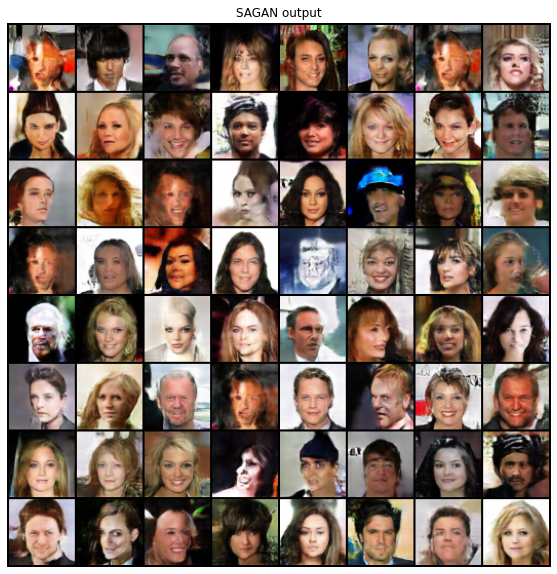

In [18]:
out = sagan.generate()
plt.figure(figsize = (10,10))
plt.axis("off")
plt.title("SAGAN output")
plt.imshow(np.transpose(vutils.make_grid(out, padding = 2, normalize = True), (1,2,0)))
plt.savefig('sagan_out.png')

In [3]:
loss_g = []
with open('/content/drive/My Drive/Colab Notebooks/sagan/1/g_loss.pkl', 'rb') as f:
    loss_g.extend(pickle.load(f))
with open('/content/drive/My Drive/Colab Notebooks/sagan/1/g_loss1.pkl', 'rb') as f:
    loss_g.extend(pickle.load(f))

loss_d = []
with open('/content/drive/My Drive/Colab Notebooks/sagan/1/d_loss.pkl', 'rb') as f:
    loss_d.extend(pickle.load(f))
with open('/content/drive/My Drive/Colab Notebooks/sagan/1/d_loss1.pkl', 'rb') as f:
    loss_d.extend(pickle.load(f))

fids = []
with open('/content/drive/My Drive/Colab Notebooks/sagan/1/fid.pkl', 'rb') as f:
    fids.extend(pickle.load(f))
with open('/content/drive/My Drive/Colab Notebooks/sagan/1/fid1.pkl', 'rb') as f:
    fids.extend(pickle.load(f))

In [9]:
x = []
for i in range(201):
    if i % 10 == 0 or i == 99:
        x.append(i)

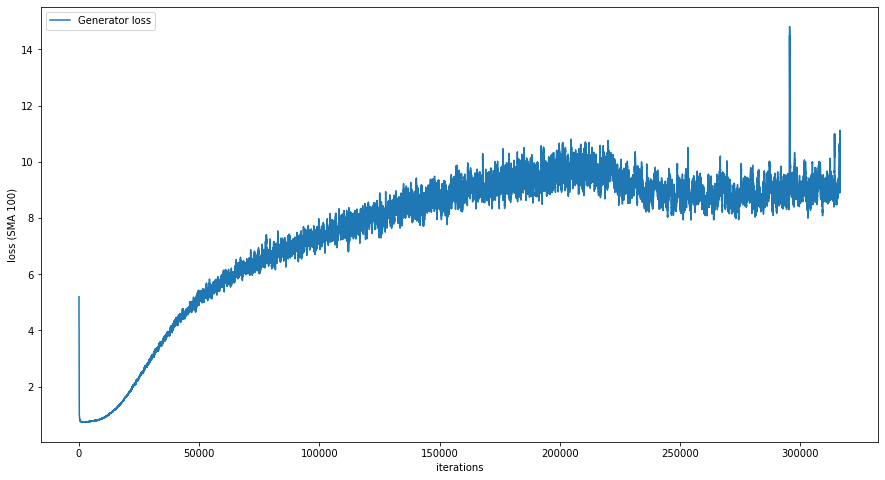

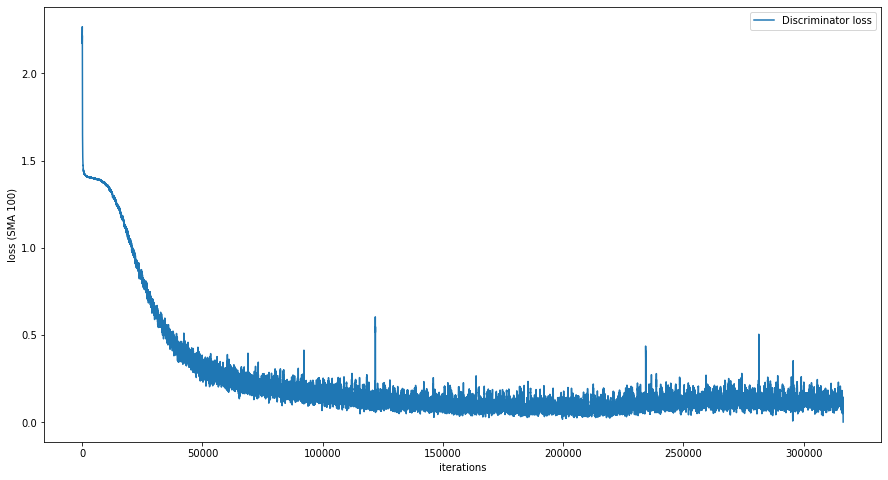

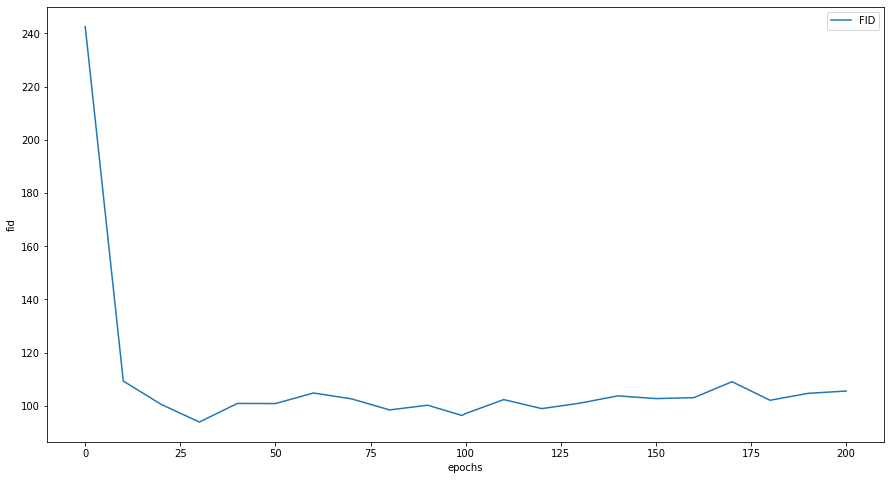

In [11]:
plt.figure(1, figsize = (15, 8))
plt.plot([np.mean(loss_g[i : i + 100]) for i in range(len(loss_g))])
plt.legend(['Generator loss'])
plt.xlabel('iterations')
plt.ylabel('loss (SMA 100)')
plt.savefig('sagan_g_loss.png')

plt.figure(2, figsize = (15, 8))
plt.plot([np.mean(loss_d[i : i + 100]) for i in range(len(loss_d))])
plt.legend(['Discriminator loss'])
plt.xlabel('iterations')
plt.ylabel('loss (SMA 100)')
plt.savefig('sagan_d_loss.png')

plt.figure(3, figsize = (15, 8))
plt.plot(x, fids)
plt.legend(['FID'])
plt.xlabel('epochs')
plt.ylabel('fid')
plt.savefig('sagan_fid.png')

In [12]:
print(min(fids))

93.95259758981706


In [13]:
fids

[242.50167546303862,
 109.34596362141548,
 100.54467854625341,
 93.95259758981706,
 100.94275734479481,
 100.89274238437511,
 104.86835206204913,
 102.65555508662516,
 98.506395698245,
 100.2731472226948,
 96.42388033347567,
 97.15541721422667,
 102.38023864359121,
 98.99832945489862,
 101.04106377693128,
 103.78146606515747,
 102.75760489993957,
 103.11697247110794,
 109.10335591964628,
 102.12764395088092,
 104.73259631131882,
 105.59750535662425]

In [4]:
_gen_imgs = []
with open('/content/drive/My Drive/Colab Notebooks/sagan/1/gen_images.pkl', 'rb') as f:
    _gen_imgs.extend(pickle.load(f))
with open('/content/drive/My Drive/Colab Notebooks/sagan/1/gen_images1.pkl', 'rb') as f:
    _gen_imgs.extend(pickle.load(f))

print(len(_gen_imgs))

418


Animation size has reached 21296777 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


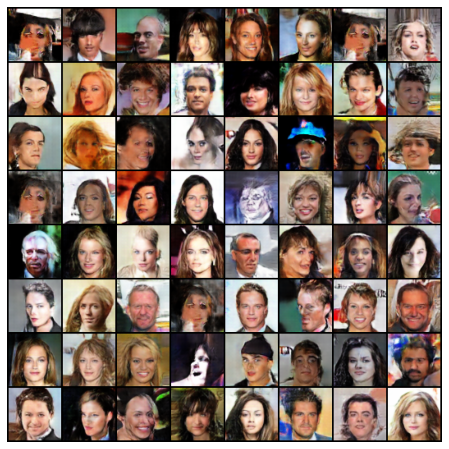

In [4]:
fig = plt.figure(figsize = (8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i, (1, 2, 0)), animated = True)] for i in _gen_imgs]
ani = animation.ArtistAnimation(fig, ims, interval = 1000, repeat_delay = 1000, blit = True)

HTML(ani.to_jshtml())

In [5]:
Writer = animation.writers['ffmpeg']
writer = Writer(fps = 6, metadata = dict(artist = 'Me'), bitrate = 1800)
ani.save('sagan_result.mp4', writer = writer)